In [1]:
import import_ipynb
import Scanpy_functions_v03262021 as sc_pipe
import scvelo as scv
scv.logging.print_version()
import warnings
import scirpy as ir
import scanpy as sc
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import seaborn as sb
import bbknn
import logging
from sklearn.mixture import GaussianMixture
from scipy.stats     import norm
import glob
import os
import hvplot.pandas
import docx
from docx import Document
from docx.shared import Inches
from docx.shared import Pt
from scipy import sparse
import scanpy.external as sce
import holoviews as hv
import panel as pn
import bokeh
from bokeh.resources import INLINE
import scanorama
import gseapy

importing Jupyter notebook from Scanpy_functions_v03262021.ipynb
Running scvelo 0.2.3 (python 3.8.5) on 2022-02-22 14:17.
Running scvelo 0.2.3 (python 3.8.5) on 2022-02-22 14:17.


In [2]:
# define sample metadata. Usually read from a file.
exclude_genes = ['Rpl', 'Rps', 'Trav', 'Traj', 'Trbj', 'Trbv','Mrp','Fau','Dap3','Uba52','Ighv', 'Igkv', 'Iglv']


In_path = '/user/ifrec/liuyuchen/scRNASeq_DATA/Akira_Fukusima_scRNASeq/'

out_path = '/user/ifrec/liuyuchen/Analysis_Reports/Akira_Fukusima_scRNASeq/'

In [3]:
#sc.set_figure_params(scanpy=True, dpi=200,  figsize=[12.8,9.6])
scv.settings.verbosity = 3  # show errors(0), warnings(1), info(2), hints(3)
scv.settings.presenter_view = True  # set max width size for presenter view
scv.set_figure_params('scvelo')  # for beautified visualization


In [4]:
adata = sc.read_h5ad(out_path+'/mouse_velocity_integrated_all_sample.h5ad')


KeyboardInterrupt: 

In [ ]:
adata

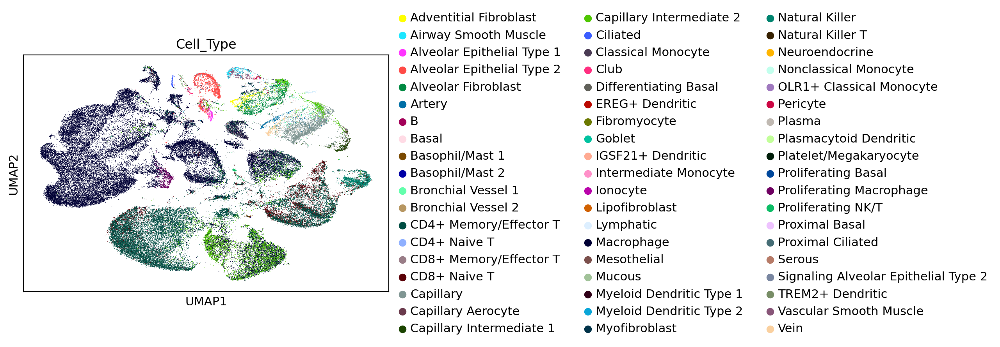

In [6]:
sc.pl.umap(adata, color ='Cell_Type')

In [7]:
adata.obs['Defined_groups'] = 'Others'
adata.obs.loc[adata.obs['leiden']=='12','Defined_groups']='Intersitial macrophage'
adata.obs.loc[adata.obs['leiden']=='4','Defined_groups']='FMF like macrophage'
adata.obs.loc[adata.obs['leiden'].isin(['0','8','30','16']),'Defined_groups']='Resident macrophage'
adata.obs.loc[adata.obs['leiden']=='17','Defined_groups']='Monocyte/macrophage'

In [8]:
adata.obs.loc[adata.obs['leiden']=='9','Defined_groups']='Ly6c high monocyte'
adata.obs.loc[adata.obs['leiden']=='14','Defined_groups']='Ly6c low monocyte'
adata.obs.loc[adata.obs['leiden']=='5','Defined_groups']='Neutrophil'
adata.obs.loc[adata.obs['leiden'].isin(['7','3','10']),'Defined_groups']='B cell'
adata.obs.loc[adata.obs['leiden'].isin(['1','22']),'Defined_groups']='T cell'
adata.obs.loc[adata.obs['leiden'].isin(['20','28']),'Defined_groups']='cDC'
adata.obs.loc[adata.obs['leiden']=='21','Defined_groups']='pDC'
adata.obs.loc[adata.obs['leiden']=='15','Defined_groups']='NK cell'
adata.obs.loc[adata.obs['leiden'].isin(['6','25']),'Defined_groups']='Endothelial cells'
adata.obs.loc[adata.obs['leiden']=='11','Defined_groups']='Fibroblast'
adata.obs.loc[adata.obs['leiden']=='23','Defined_groups']='Smooth muscle cell'
adata.obs.loc[adata.obs['leiden']=='27','Defined_groups']='Type1 and regenerative epithelium'
adata.obs.loc[adata.obs['leiden']=='29','Defined_groups']='BAL SatM like cell'
adata.obs.loc[adata.obs['leiden']=='18','Defined_groups']='Lung SatM like cell'

... storing 'Defined_groups' as categorical


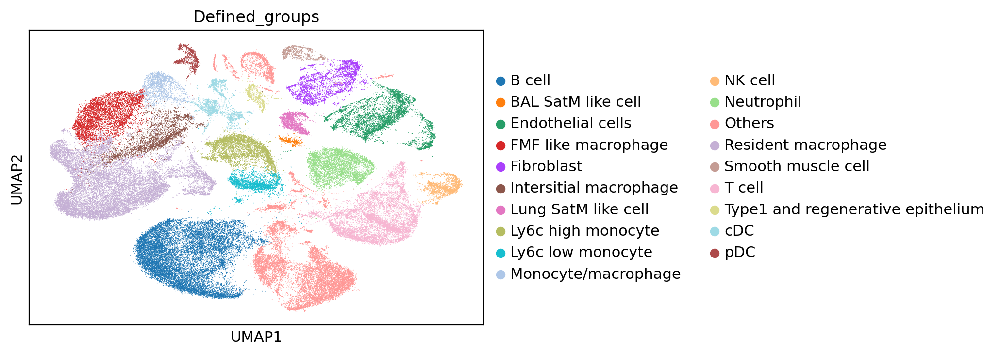

In [9]:
sc.pl.umap(adata, color = 'Defined_groups')

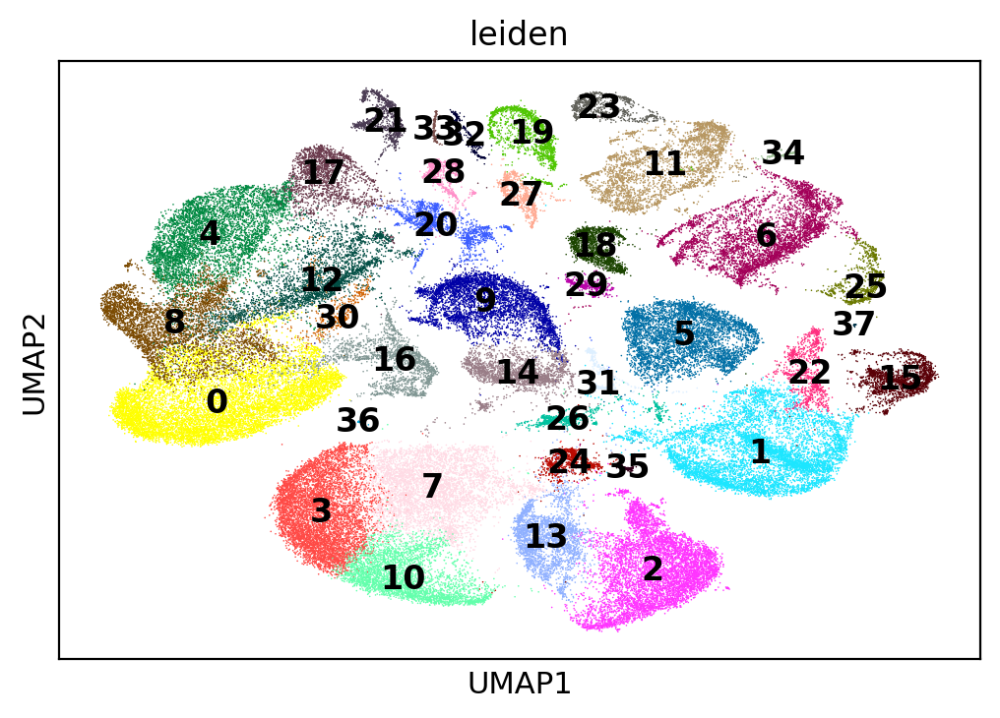

In [10]:
sc.pl.umap(adata, color = 'leiden', legend_loc='on data')

In [11]:
sub = adata[adata.obs['leiden'].isin(['9','12','30','16','0','8','4','14','17','18','29'])].copy()

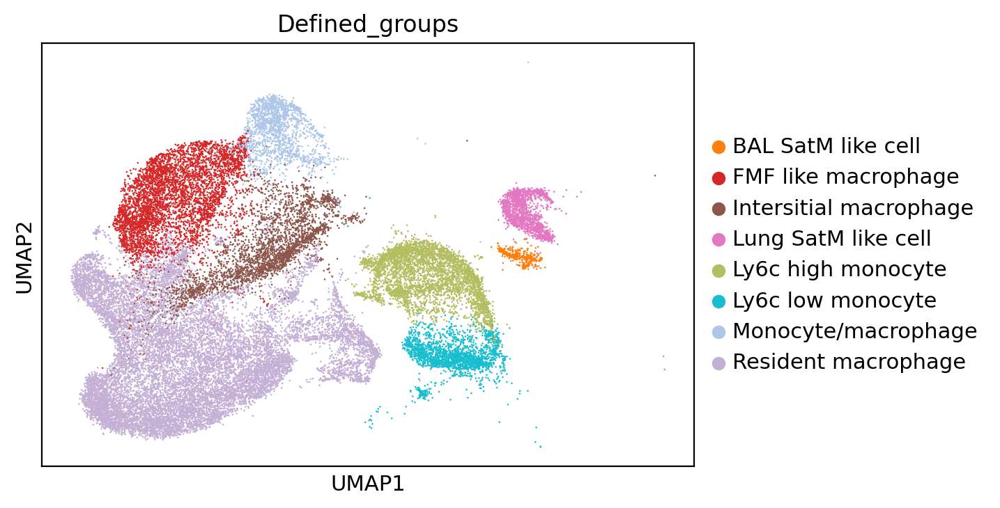

In [12]:
sc.pl.umap(sub, color = 'Defined_groups')

In [13]:
for k in [ 'fit_r2', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s', 'fit_variance', 'fit_alignment_scaling', 'velocity_genes']:
    del sub.var[k]

In [14]:
del sub.layers['Ms'] 
del sub.layers['Mu'] 

In [15]:
sc.pp.neighbors(sub)

computing neighbors
    finished (0:00:12) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:09) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
recovering dynamics (using 20/352 cores)


  0%|          | 0/97 [00:00<?, ?gene/s]

    finished (0:04:15) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:12) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:10) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
calculating cell cycle phase
-->     'S_score' and 'G2M_score', scores of cell cycle phases (adata.obs)


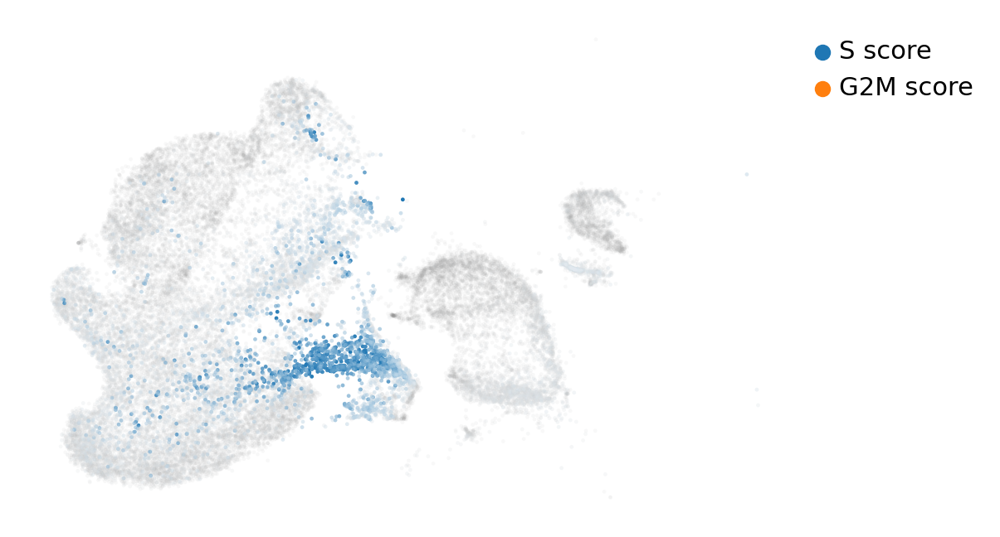

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)


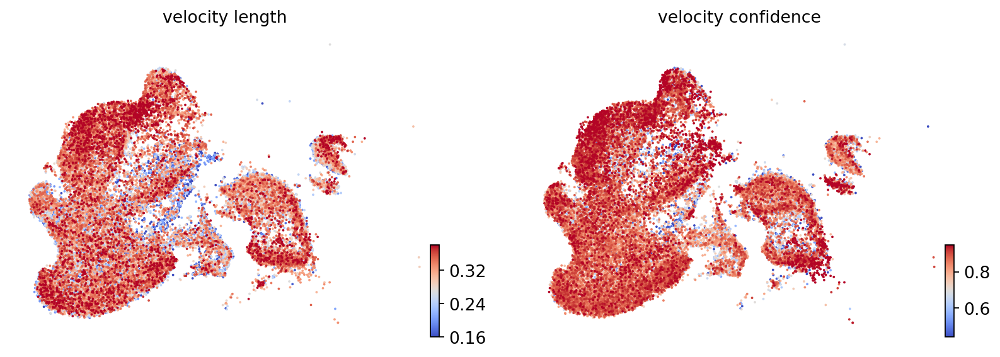

computing velocity embedding
    finished (0:00:15) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


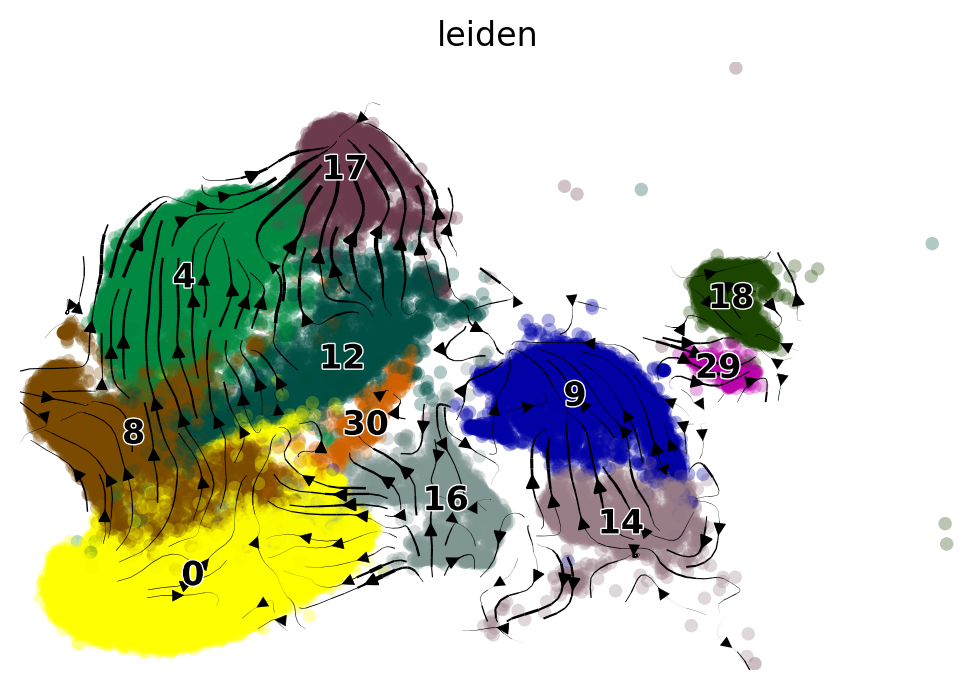

In [16]:
scv.pp.moments(sub, n_pcs=30, n_neighbors=30)
scv.tl.recover_dynamics(sub,n_jobs=20)
scv.tl.velocity(sub, mode='dynamical')
scv.tl.velocity_graph(sub)
scv.tl.score_genes_cell_cycle(sub)
scv.pl.scatter(sub, color_gradients=['S_score', 'G2M_score'], smooth=True, perc=[5, 95])
scv.tl.velocity_confidence(sub)
keys = 'velocity_length', 'velocity_confidence'
scv.pl.scatter(sub, c=keys, cmap='coolwarm', perc=[5, 95])
#scv.pl.paga(adata, basis='umap', size=50, alpha=.1,min_edge_width=2, node_size_scale=0.5)
scv.pl.velocity_embedding_stream(sub, basis='umap',color = 'leiden')

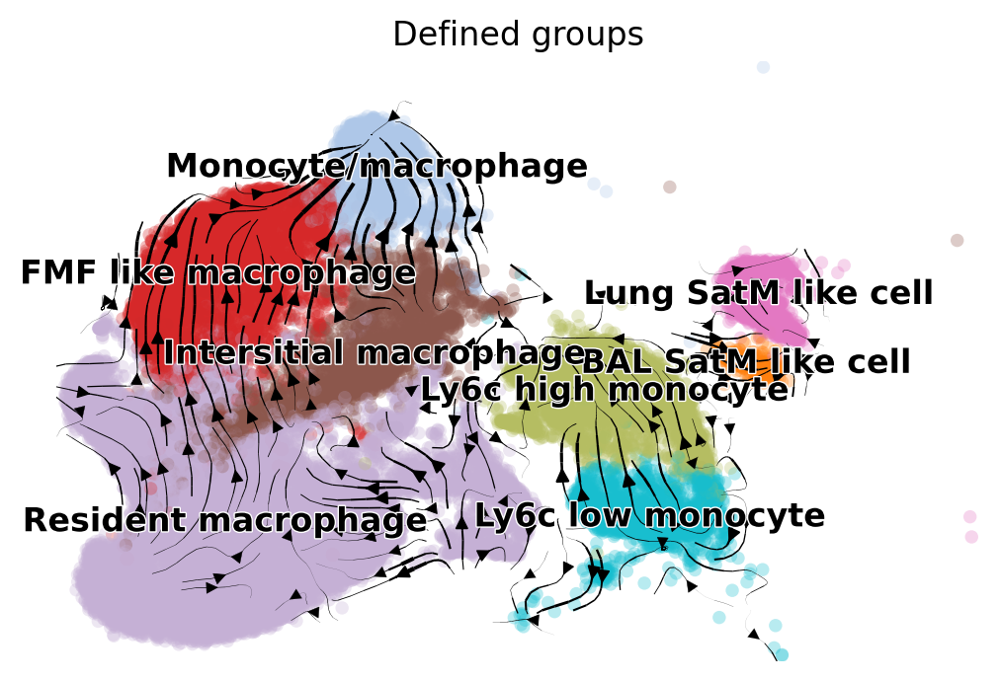

In [17]:
scv.pl.velocity_embedding_stream(sub, basis='umap',color = 'Defined_groups')

In [18]:
sub

AnnData object with n_obs × n_vars = 35079 × 22233
    obs: 'Sample', 'batch', 'pct_counts_mt', 'pct_counts_ribo', 'pct_counts_hb', 'doublet_score', 'n_counts', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'log_counts', 'leiden', 'Conditions', 'Organ', 'Cell_Type', 'SatM_like', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'velocity_self_transition', 'S_score', 'G2M_score', 'phase', 'clusters_gradients', 'velocity_length', 'velocity_confidence', 'velocity_confidence_transition', 'root_cells', 'end_points', 'velocity_pseudotime', 'latent_time', 'Defined_groups'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_nor

In [19]:
for k in ['root_cells', 'end_points', 'velocity_pseudotime', 'latent_time']:
    del sub.obs[k]

computing terminal states
    identified 8 regions of root cells and 4 regions of end points .
    finished (0:00:09) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
computing latent time using root_cells as prior
    finished (0:00:33) --> added 
    'latent_time', shared time (adata.obs)


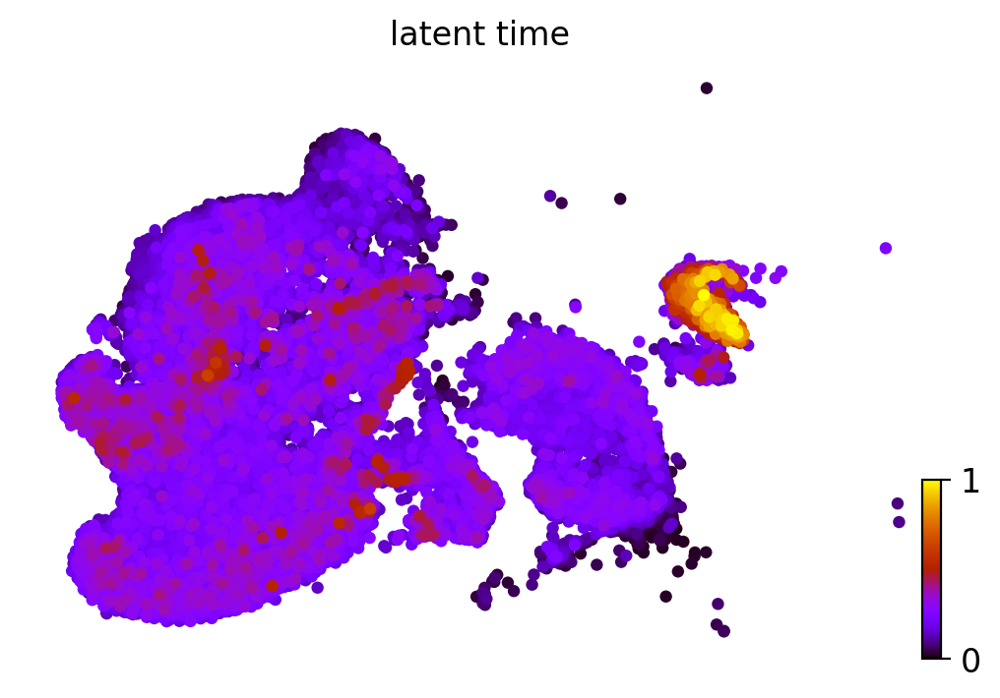

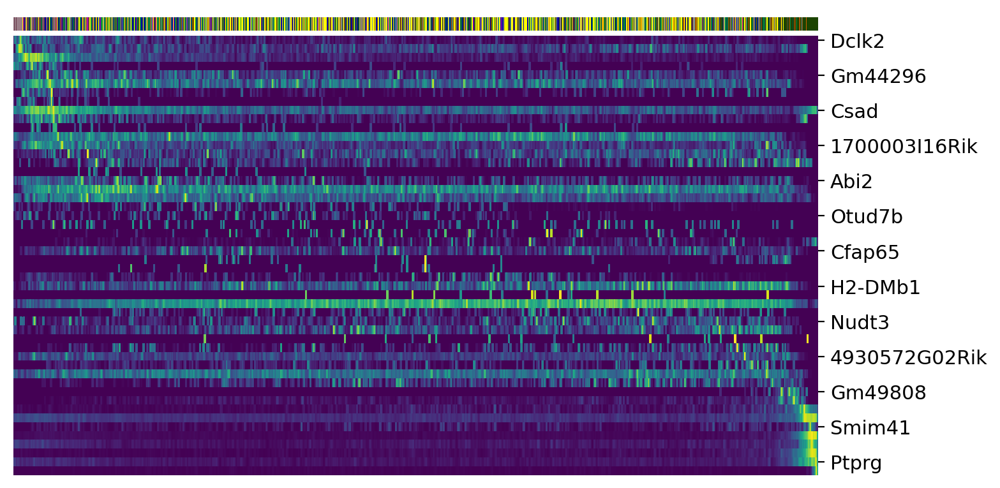

running PAGA using priors: ['latent_time']
    finished (0:00:11) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


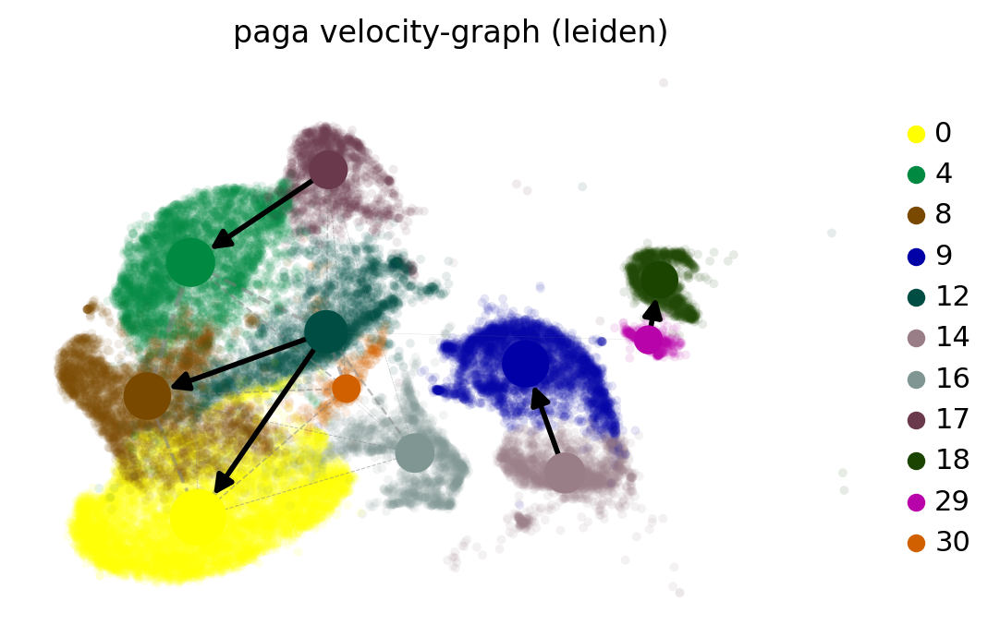

In [20]:
scv.tl.latent_time(sub)
scv.pl.scatter(sub, color='latent_time', color_map='gnuplot', size=80)
top_genes = sub.var['fit_likelihood'].sort_values(ascending=False).index[:50]
scv.pl.heatmap(sub, var_names=top_genes, sortby='latent_time', col_color='leiden', n_convolve=100)
scv.tl.paga(sub, groups='leiden',use_time_prior='latent_time')
scv.pl.paga(sub, basis='umap', size=50, alpha=.1,
            min_edge_width=2, node_size_scale=1.5)

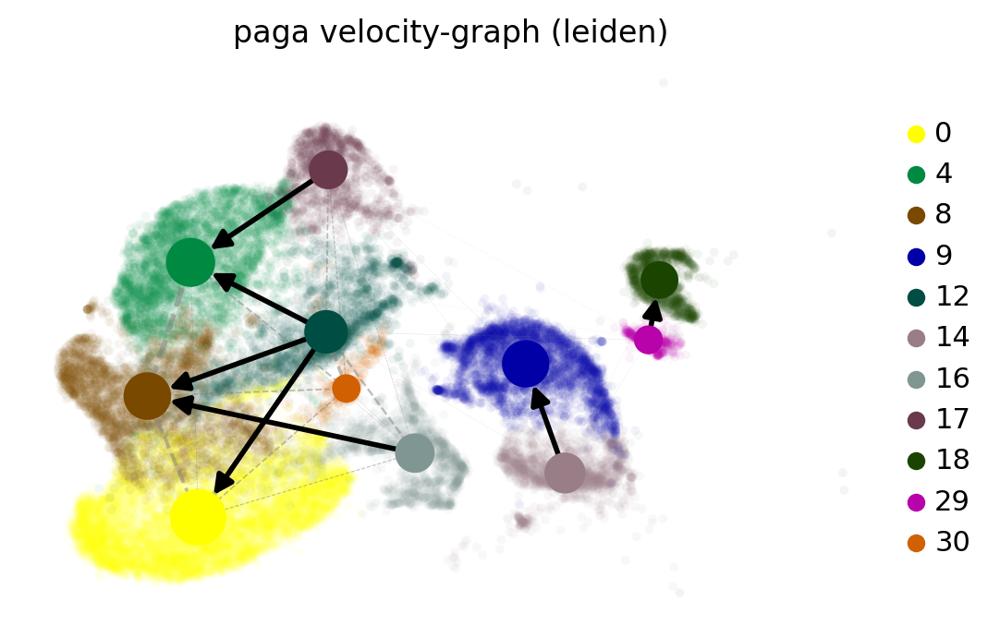

In [21]:
scv.pl.paga(sub, basis='umap', size=50, alpha=.05,threshold=0,
            min_edge_width=2, node_size_scale=1.5)

running PAGA using priors: ['latent_time']
    finished (0:00:12) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


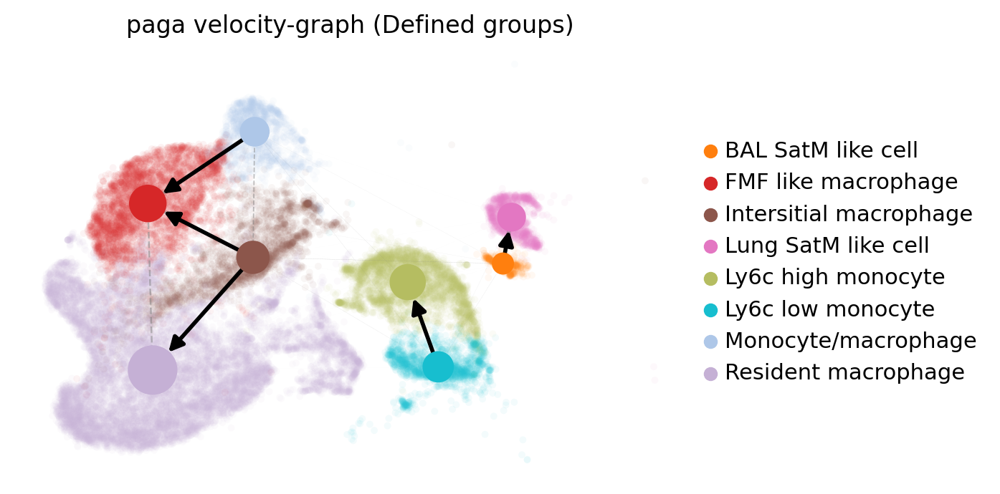

In [22]:
scv.tl.paga(sub, groups= 'Defined_groups',use_time_prior='latent_time')
scv.pl.paga(sub, basis='umap', size=50, alpha=.05,threshold=0,
            min_edge_width=2, node_size_scale=1.5)

In [23]:
human_mouse= pd.read_csv('./mouse_human_genes.txt')
mous_homolog = dict(zip(human_mouse['Gene name'],human_mouse['Human gene name']))

x = [g for g in set(adata.var_names).intersection(mous_homolog.keys())]
adata = adata[:,x]




In [24]:
adata.var_names= adata.var_names.map(mous_homolog).fillna('NA')

In [5]:
cellphone_folder = out_path+"/cellphonedb/"

In [26]:
adata.var_names_make_unique()

In [27]:
x = adata.var[adata.var_names!='NA'].index.tolist()


In [28]:
adata = adata[:,x]
adata.write_h5ad(cellphone_folder+'/mouse_with_human_homolog.h5ad')

In [30]:
sub.write_h5ad(out_path+'/sub_velocity.h5ad')

In [31]:
adata.obs['Defined_groups'].to_csv(cellphone_folder+'/mouse_meta.tsv',sep="\t")

In [34]:
adata.raw.var_names

Index(['Gm8909', 'Txnl4a', '4930590J08Rik', 'Lhx1os', '2810433D01Rik', 'Papln',
       'Fam8a1', 'Tmem115', 'Gm5820', 'Zfp664',
       ...
       'Gm43604', 'Trio', 'Ehbp1l1', 'Gm17139', 'Tbc1d30', 'Map2',
       '2310068J16Rik', 'Zmiz2', 'Thada', 'Oprm1'],
      dtype='object', length=22233)

In [6]:
import itertools

In [7]:
def Plot_cluster_pair(combo,cpdb_mean):
    a =combo[0]+'|'+combo[1]
    b =combo[1]+'|'+combo[0]
    x = cpdb_mean[pd.notna(cpdb_mean[a])][['interacting_pair',a]]
    new = x['interacting_pair'].str.split("_", n=1 ,expand = True)
    x[combo[0]] = new[0]
    x[combo[1]] = new[1]
    y=x.pivot_table(columns=combo[0], index=combo[1], values=a)
    x = cpdb_mean[pd.notna(cpdb_mean[b])][['interacting_pair',b]]
    new = x['interacting_pair'].str.split("_", n=1 ,expand = True)
    x[combo[1]] = new[0]
    x[combo[0]] = new[1]
    z=x.pivot_table(columns=combo[1], index=combo[0], values=b)
    fig, axs = plt.subplots(1,2,figsize=(25,10))
    fig.suptitle('Cell Cell Communication between '+combo[0]+' and '+combo[1])
    axs[0].set_title(combo[0]+' to '+combo[1])
    sb.heatmap(y,ax=axs[0],linewidths=0.5,xticklabels=1, yticklabels=1)
    axs[1].set_title(combo[1]+' to '+combo[0])
    sb.heatmap(z,ax=axs[1],linewidths=0.5,xticklabels=1, yticklabels=1)

In [8]:
cpdb_mean = pd.read_csv(cellphone_folder+'/out/significant_means.txt',sep='\t')

## Interaction of Defined Groups 

In [9]:
cpdb_mean

,id_cp_interaction,interacting_pair,partner_a,partner_b,gene_a,gene_b,secreted,receptor_a,receptor_b,annotation_strategy,...,pDC|Monocyte/macrophage,pDC|NK cell,pDC|Neutrophil,pDC|Others,pDC|Resident macrophage,pDC|Smooth muscle cell,pDC|T cell,pDC|Type1 and regenerative epithelium,pDC|cDC,pDC|pDC
0,CPI-SS0273C9AED,KDR_VEGFC,simple:P35968,simple:P49767,KDR,VEGFC,True,True,False,curated,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,CPI-SS0E32BEF02,WNT5A_FZD5,simple:P41221,simple:Q13467,WNT5A,FZD5,True,False,True,curated,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,CPI-SS0C4D54E39,NOTCH3_JAG2,simple:Q9UM47,simple:Q9Y219,NOTCH3,JAG2,False,True,False,curated,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,CPI-SS093E05DD4,NTF3_NTRK2,simple:P20783,simple:Q16620,NTF3,NTRK2,True,False,True,curated,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,CPI-SS0C875BA24,EFNA2_EPHA3,simple:O43921,simple:P29320,EFNA2,EPHA3,True,False,True,curated,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
984,CPI-SS0FC2B68F1,IAPP_IDE,simple:P10997,simple:P14735,IAPP,IDE,True,False,True,IMEx,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
985,CPI-SS0579FA162,IGF2_IGF1R,simple:P01344,simple:P08069,IGF2,IGF1R,True,False,True,curated,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
986,CPI-SS042A6F835,IGF2_IGF2R,simple:P01344,simple:P11717,IGF2,IGF2R,True,False,True,curated,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
987,CPI-SC09458C6C0,IFNA5_Type I IFNR,simple:P01569,complex:Type I IFNR,IFNA5,NaN,True,False,True,curated,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


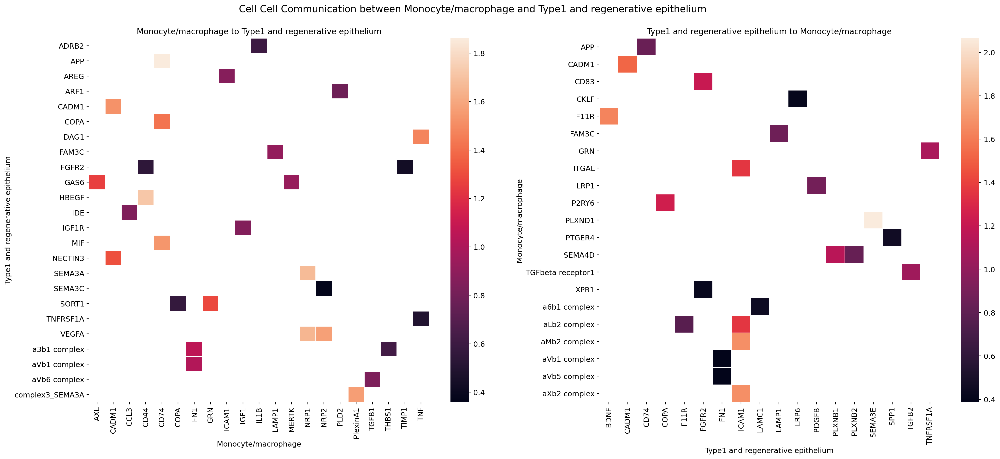

In [10]:
Plot_cluster_pair(('Monocyte/macrophage','Type1 and regenerative epithelium'),cpdb_mean)

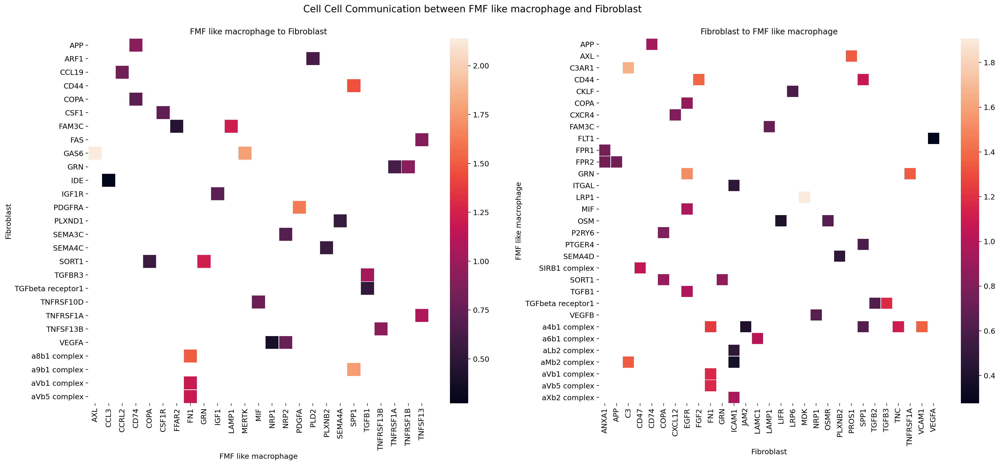

In [11]:
Plot_cluster_pair(('FMF like macrophage','Fibroblast'),cpdb_mean)

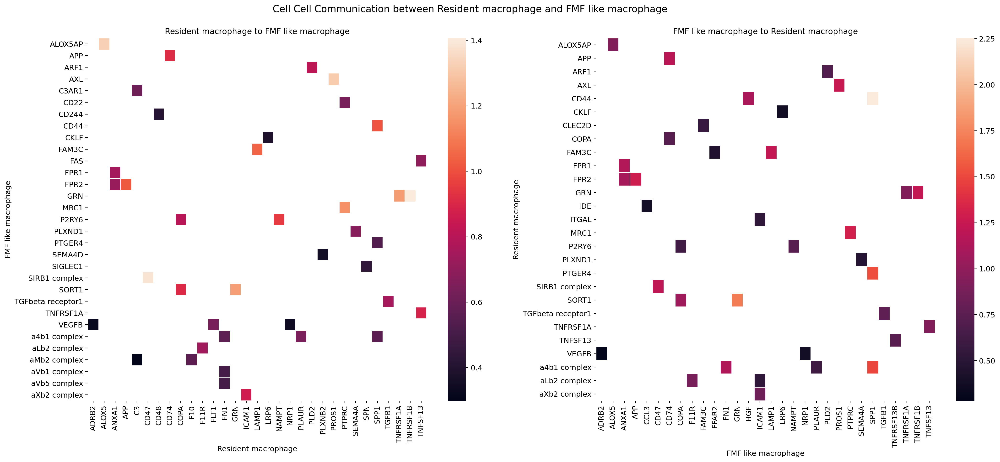

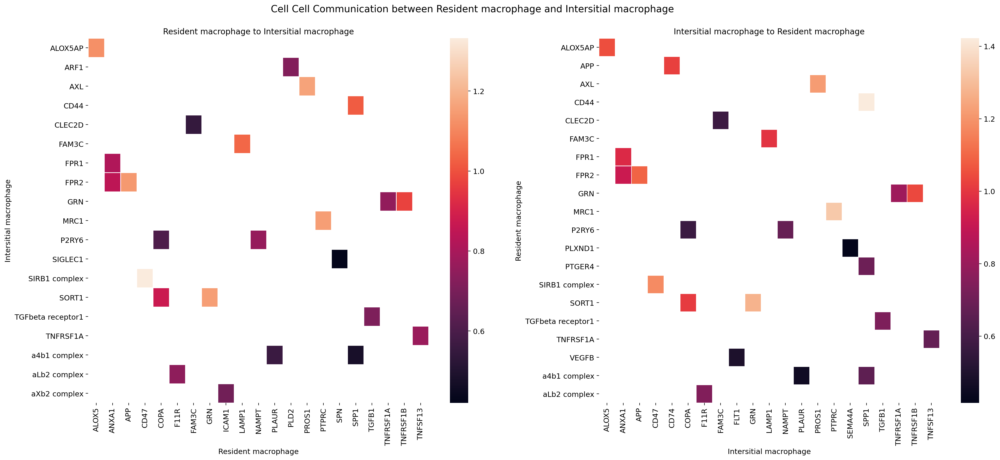

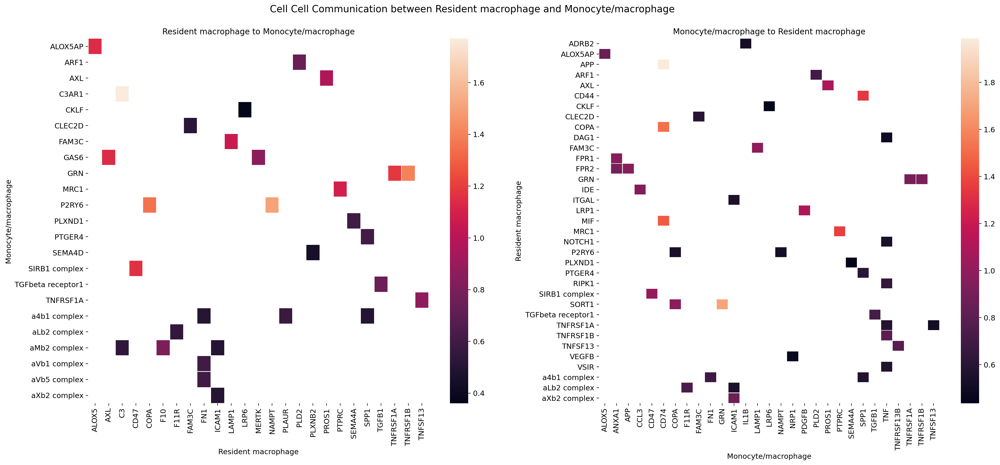

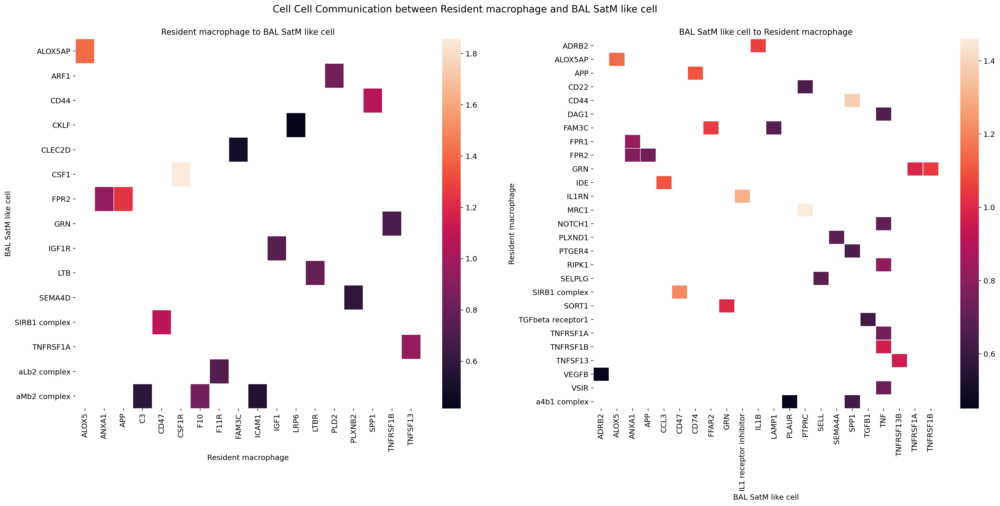

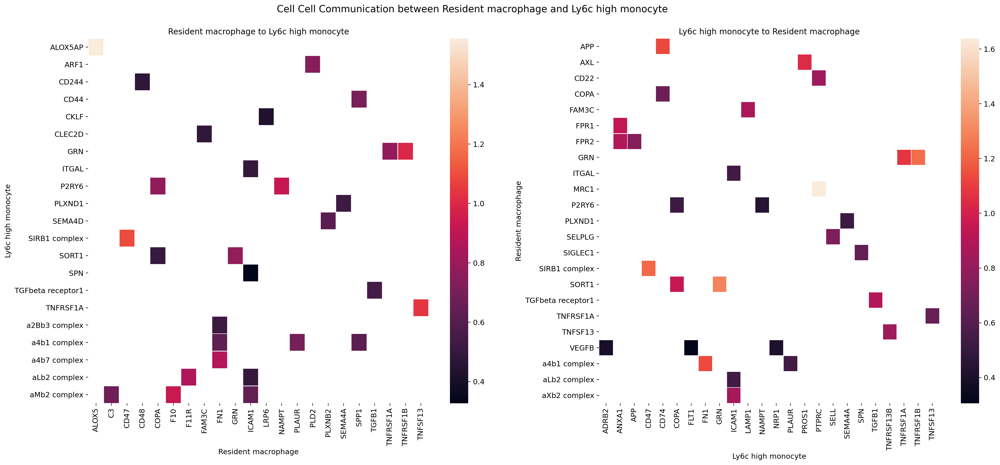

...

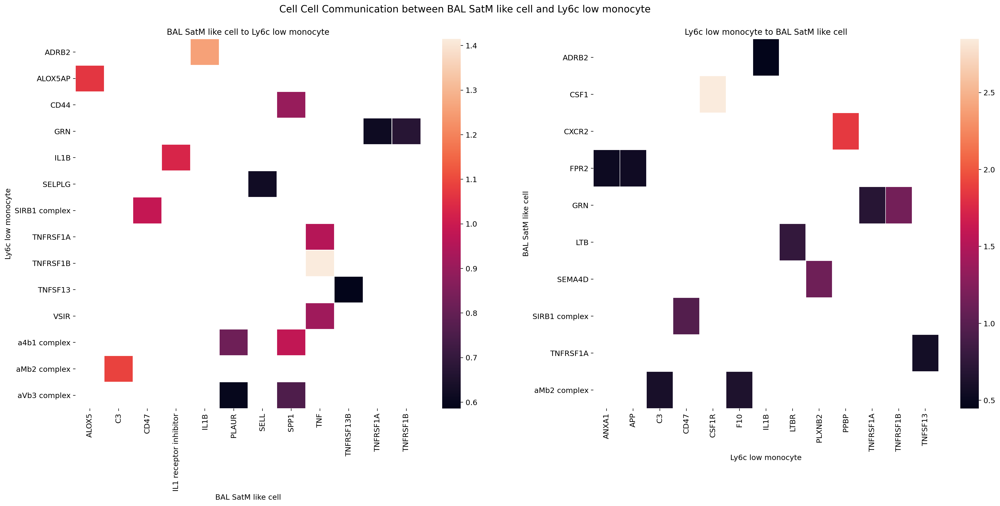

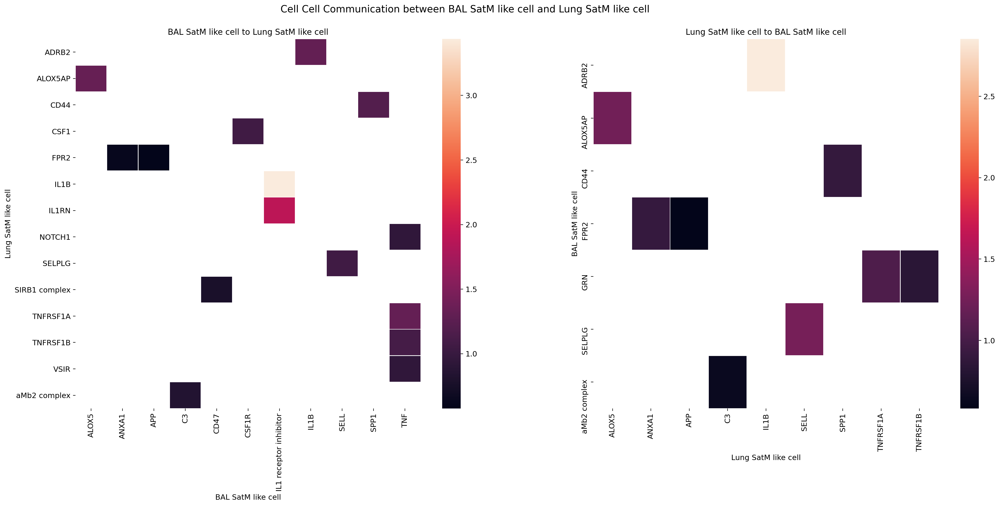

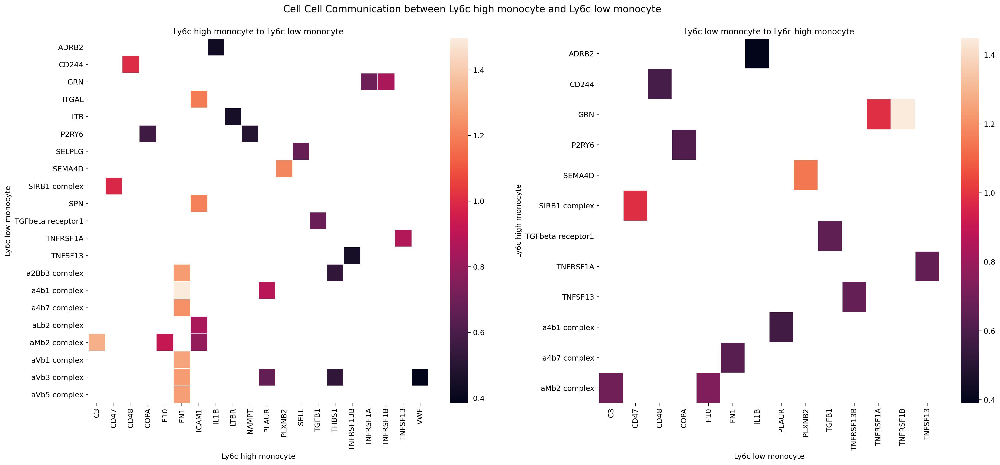

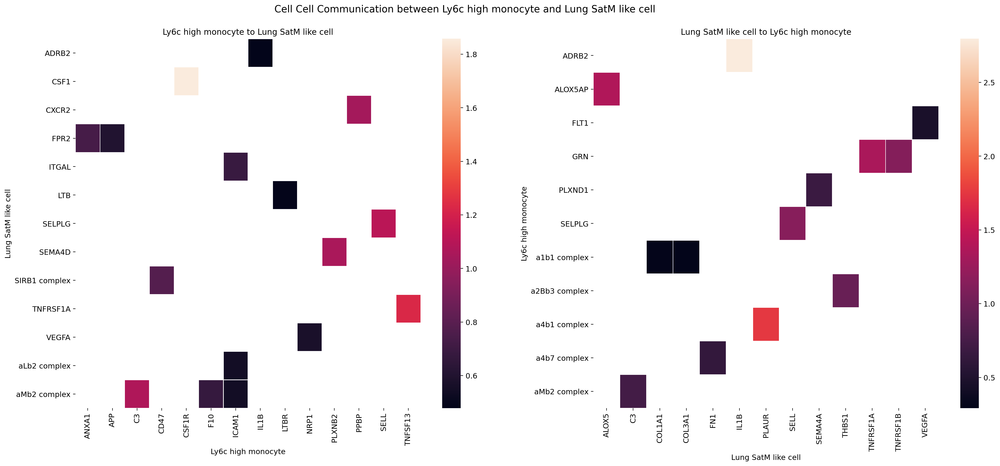

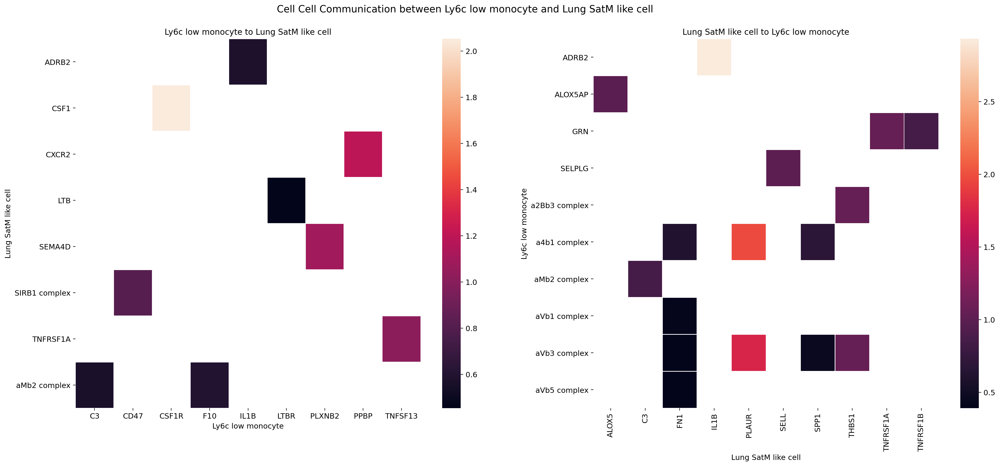

In [41]:
groups = sub.obs['Defined_groups'].unique().tolist()

for combo in itertools.combinations(groups, 2):
    Plot_cluster_pair(combo,cpdb_mean)cd

## TF MF analysis

In [45]:
import dorothea
regulons = dorothea.load_regulons(
    ['A','B','C','D','E'],   # Which levels of confidence to use (A most confident, E least confident)
    organism='Mouse' # If working with mouse, set to Mouse
)

In [46]:
dorothea.run(adata,        # Data to use
             regulons,     # Dorothea network
             center=True,  # Center gene expression by mean per cell
             num_perm=100, # Simulate m random activities
             norm=True,    # Normalize by number of edges to correct for large regulons
             scale=True,   # Scale values per feature so that values can be compared across cells
             use_raw=True, # Use raw adata, where we have the lognorm gene expression
             min_size=5,   # TF with less than 5 targets will be ignored
            )

15608 targets found
12 TFs with < 5 targets


100%|██████████| 100/100 [48:04<00:00, 28.85s/it]


In [47]:
TF_anndata = dorothea.extract(adata)

In [48]:
TF_anndata.write(out_path+'/TF_anndata.h5ad')


## Top differential TF activity by each cell type V.S. rest of the cells

In [56]:
tfs = dict()
for g in groups:
    df = dorothea.rank_tfs_groups(adata, groupby='Defined_groups', group=g)
    df.to_csv(out_path+'/Differential_TF_'+g.replace(' ','').replace('/','_')+'.csv')
    tf = df.head(4).index.values
    tfs[g] = tf
    


categories: B cell, BAL SatM like cell, Endothelial cells, etc.
var_group_labels: Resident macrophage, FMF like macrophage, Intersitial macrophage, etc.


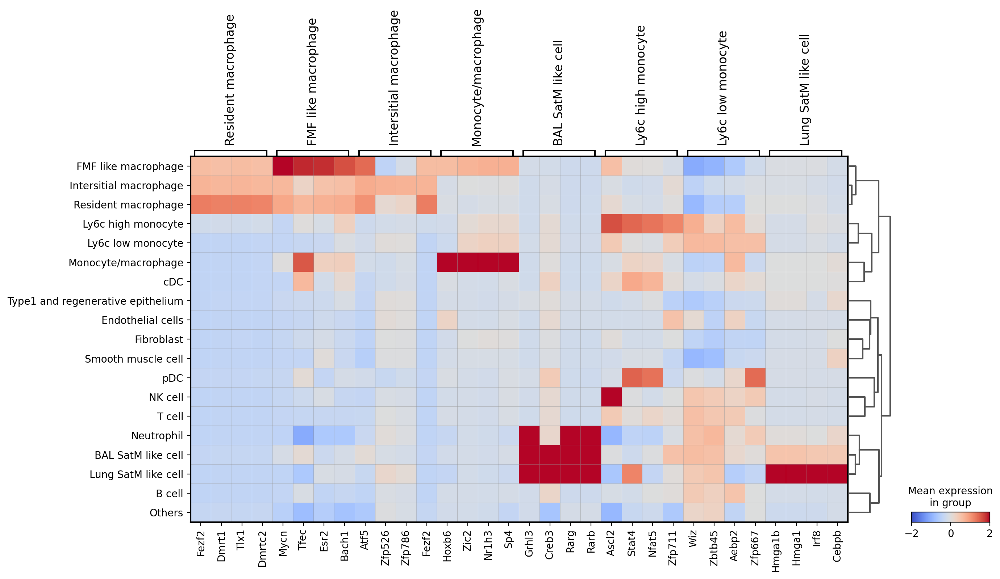

In [57]:
sc.pl.matrixplot(dorothea.extract(adata), tfs,'Defined_groups' , dendrogram=True, cmap='coolwarm', vmin=-2, vmax=2)

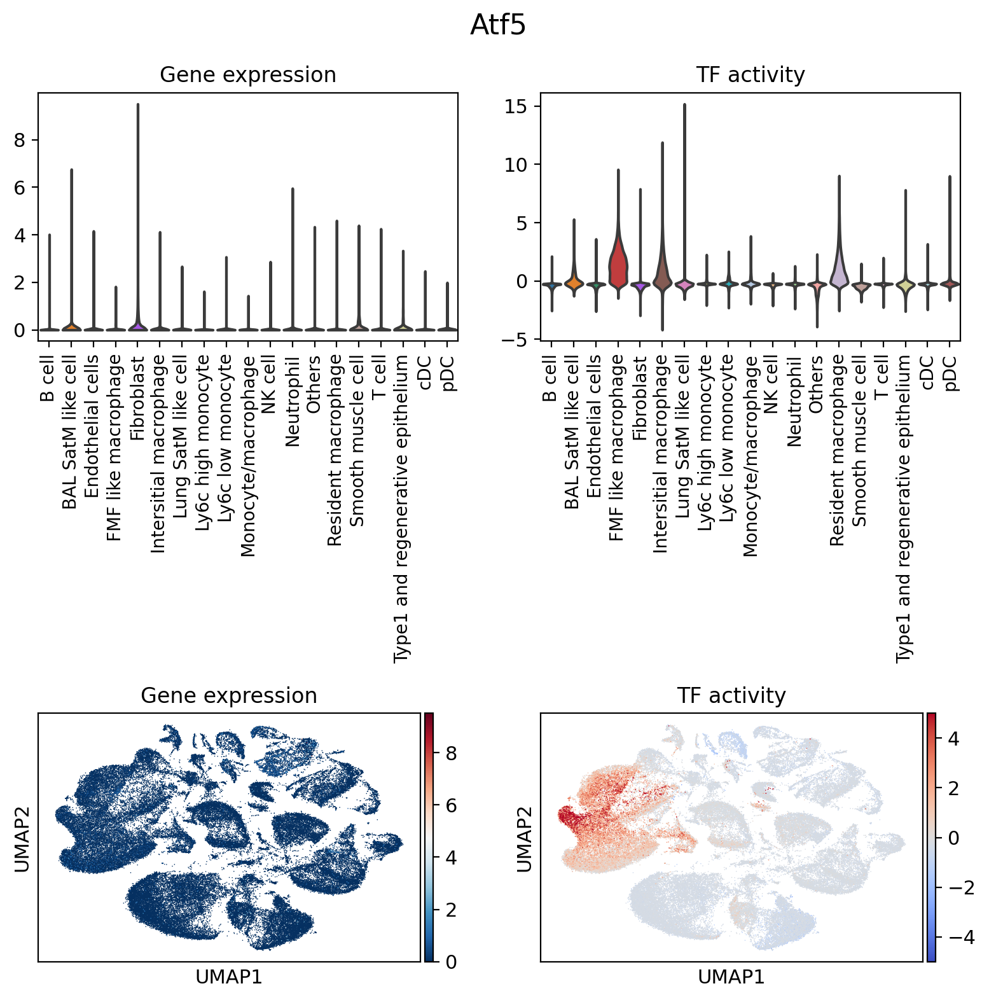

In [58]:
fig, ax = plt.subplots(2,2, figsize=(8,8), tight_layout=True, facecolor='white')
ax = ax.flatten()

tf = 'Atf5'
fig.suptitle(tf, fontsize=16)
sc.pl.violin(adata, keys=tf, groupby='Defined_groups', stripplot=False, ax=ax[0], show=False)
ax[0].tick_params(axis='x', rotation=90, labelsize=10)
ax[0].set_ylabel('')
ax[0].set_xlabel('')
ax[0].set_title('Gene expression')

sc.pl.violin(dorothea.extract(adata), keys=tf, groupby='Defined_groups', stripplot=False, ax=ax[1], show=False)
ax[1].tick_params(axis='x', rotation=90, labelsize=10)
ax[1].set_ylabel('')
ax[1].set_xlabel('')
ax[1].set_title('TF activity')

sc.pl.umap(adata, color=tf, return_fig=False, ax=ax[2], show=False)
ax[2].set_title('Gene expression')
sc.pl.umap(dorothea.extract(adata), color=tf, vmin=-5, vmax=5, cmap='coolwarm', return_fig=False, ax=ax[3], show=False)
ax[3].set_title('TF activity')

plt.show()

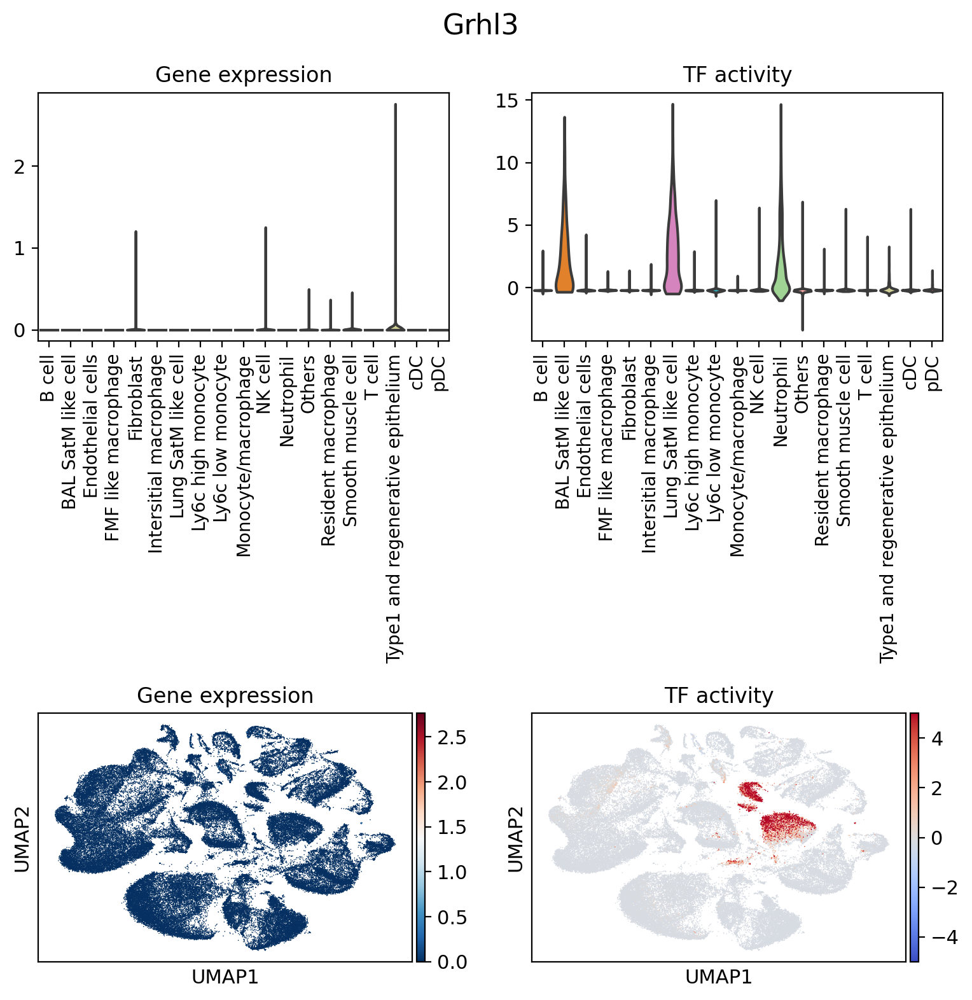

In [59]:
fig, ax = plt.subplots(2,2, figsize=(8,8), tight_layout=True, facecolor='white')
ax = ax.flatten()

tf = 'Grhl3'
fig.suptitle(tf, fontsize=16)
sc.pl.violin(adata, keys=tf, groupby='Defined_groups', stripplot=False, ax=ax[0], show=False)
ax[0].tick_params(axis='x', rotation=90, labelsize=10)
ax[0].set_ylabel('')
ax[0].set_xlabel('')
ax[0].set_title('Gene expression')

sc.pl.violin(dorothea.extract(adata), keys=tf, groupby='Defined_groups', stripplot=False, ax=ax[1], show=False)
ax[1].tick_params(axis='x', rotation=90, labelsize=10)
ax[1].set_ylabel('')
ax[1].set_xlabel('')
ax[1].set_title('TF activity')

sc.pl.umap(adata, color=tf, return_fig=False, ax=ax[2], show=False)
ax[2].set_title('Gene expression')
sc.pl.umap(dorothea.extract(adata), color=tf, vmin=-5, vmax=5, cmap='coolwarm', return_fig=False, ax=ax[3], show=False)
ax[3].set_title('TF activity')

plt.show()

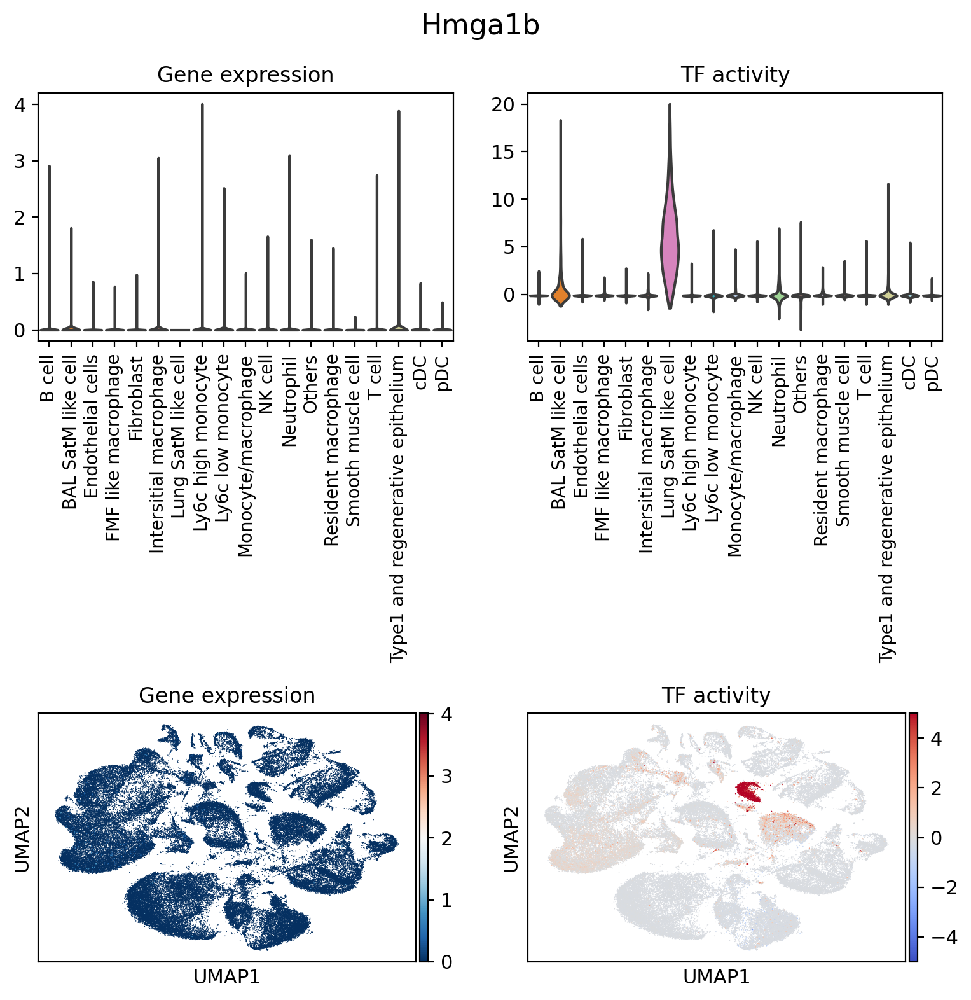

In [60]:
fig, ax = plt.subplots(2,2, figsize=(8,8), tight_layout=True, facecolor='white')
ax = ax.flatten()

tf = 'Hmga1b'
fig.suptitle(tf, fontsize=16)
sc.pl.violin(adata, keys=tf, groupby='Defined_groups', stripplot=False, ax=ax[0], show=False)
ax[0].tick_params(axis='x', rotation=90, labelsize=10)
ax[0].set_ylabel('')
ax[0].set_xlabel('')
ax[0].set_title('Gene expression')

sc.pl.violin(dorothea.extract(adata), keys=tf, groupby='Defined_groups', stripplot=False, ax=ax[1], show=False)
ax[1].tick_params(axis='x', rotation=90, labelsize=10)
ax[1].set_ylabel('')
ax[1].set_xlabel('')
ax[1].set_title('TF activity')

sc.pl.umap(adata, color=tf, return_fig=False, ax=ax[2], show=False)
ax[2].set_title('Gene expression')
sc.pl.umap(dorothea.extract(adata), color=tf, vmin=-5, vmax=5, cmap='coolwarm', return_fig=False, ax=ax[3], show=False)
ax[3].set_title('TF activity')

plt.show()

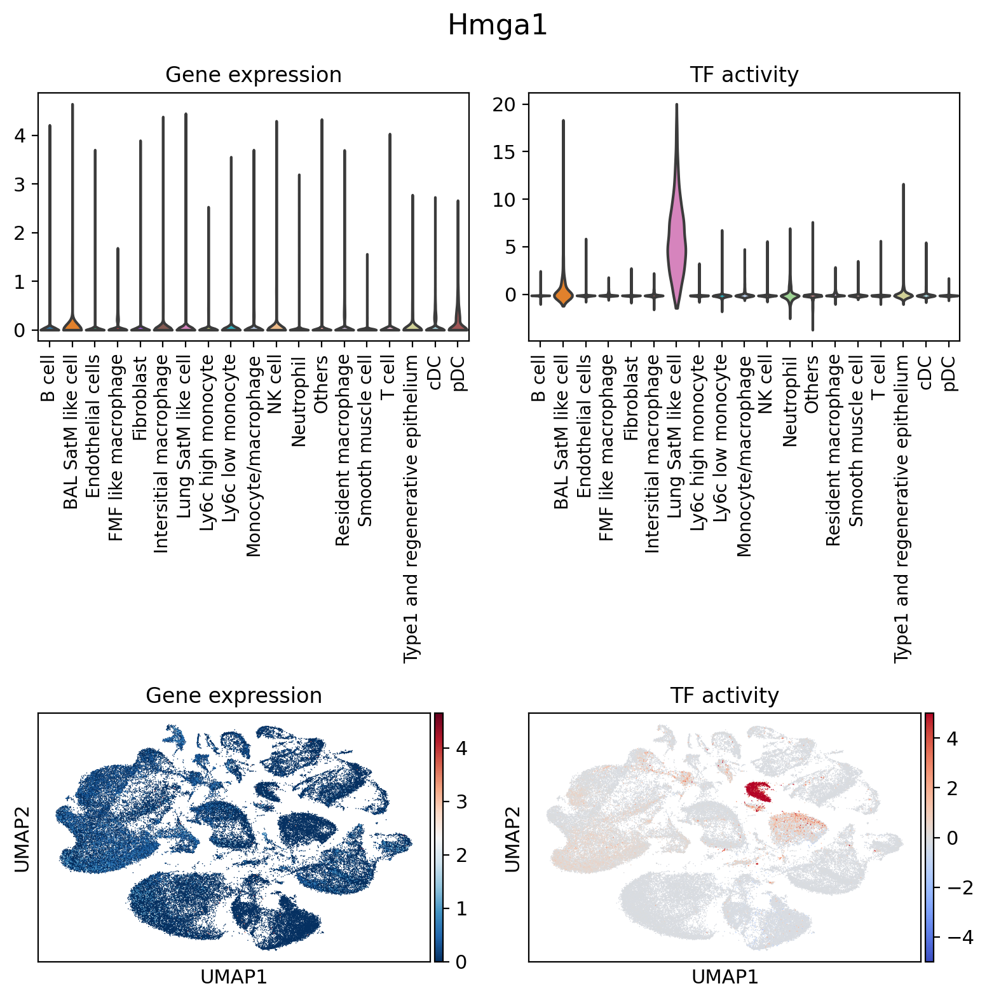

In [61]:
fig, ax = plt.subplots(2,2, figsize=(8,8), tight_layout=True, facecolor='white')
ax = ax.flatten()

tf = 'Hmga1'
fig.suptitle(tf, fontsize=16)
sc.pl.violin(adata, keys=tf, groupby='Defined_groups', stripplot=False, ax=ax[0], show=False)
ax[0].tick_params(axis='x', rotation=90, labelsize=10)
ax[0].set_ylabel('')
ax[0].set_xlabel('')
ax[0].set_title('Gene expression')

sc.pl.violin(dorothea.extract(adata), keys=tf, groupby='Defined_groups', stripplot=False, ax=ax[1], show=False)
ax[1].tick_params(axis='x', rotation=90, labelsize=10)
ax[1].set_ylabel('')
ax[1].set_xlabel('')
ax[1].set_title('TF activity')

sc.pl.umap(adata, color=tf, return_fig=False, ax=ax[2], show=False)
ax[2].set_title('Gene expression')
sc.pl.umap(dorothea.extract(adata), color=tf, vmin=-5, vmax=5, cmap='coolwarm', return_fig=False, ax=ax[3], show=False)
ax[3].set_title('TF activity')

plt.show()